# KNN

## Business Objective
To make this into an unsupervised learning problem the objective will need to change. This model is now attempting to understand what insights different feature clusters can offer in relation to understanding how different fields may impact the close price of the stock.

In [1]:
# Imports
import pandas as pd
import seaborn as sns
from sklearn import pipeline
import itertools
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from matplotlib import pyplot as plt

In [2]:
# Read csv into dataframe

df = pd.read_csv(r'C:\Users\connor\PycharmProjects\trading\data\analytics\analytics_voo.csv', usecols=['date', 'open', 'high', 'low', 'close', 'volume', 'CPALTT01USM657N', 'DFF', 'EXPINF10YR', 'GDPC1', 'RSXFS', 'T10YFF', 'UNRATE', 'macd', 'macd_signal', 'macd_hist', 'daily_obv', 'seven_day_ema', 'target'])

In [3]:
df = df.where(df.date >= '2023-01-01')
df.dropna(inplace=True)
df.drop(columns=['date'], inplace=True)
df.reset_index(drop=True, inplace=True)

In [4]:
plot = sns.pairplot(df, hue='target', diag_kind='hist', height=5)

In [5]:
plot.savefig(r"C:\Users\connor\PycharmProjects\trading\visuals\pairplot_scatter.png") 

In [6]:
column_list = [column for column in df.columns if column != 'target']
cluster_pair_combo = itertools.combinations(column_list, 2)

In [7]:
# create pipeline object with scaling preprocessing step and KMeans model
# KMeans is sensitive to differing scales between columns so need to scale the data first
# n_clusters = 2. Want to find a single feature that has the most impact on close price
pipe_kmeans = pipeline.make_pipeline(
    StandardScaler(),
    KMeans(n_clusters=2,
            init='random',
            n_init=10,
            max_iter=300,
            tol=1e-04,                      
            random_state=0)
)

In [8]:
kmeans_model = KMeans(n_clusters=2,
        init='random',
        n_init=10,
        max_iter=300,
        tol=1e-04,
        random_state=0)

In [9]:
def print_cluster(model, n_clusters, X):
    y_km = model.fit_predict(X)
    predictions = pd.DataFrame(y_km, columns=['cluster_group'])
    data = pd.concat([X, predictions], ignore_index=True, axis=1)
    data.columns = [X.columns[0], X.columns[1], 'clusters']
    
    marker_list = ['s', 'x', 'd', 'o']
    color_list = ['lightgreen', 'orange', 'lightblue', 'red', 'yellow', 'brown', 'cyan']
    for i in range(n_clusters):
        sns.scatterplot(
        data=data,
        x=data[data.columns[0]],
        y=data[data.columns[1]],
        hue=data[data.columns[2]],
        s=50,
        c=color_list[2*i],
        marker=marker_list[2*i],
        #label='cluster ' + str(i)
        )
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.clabel
    plt.show()

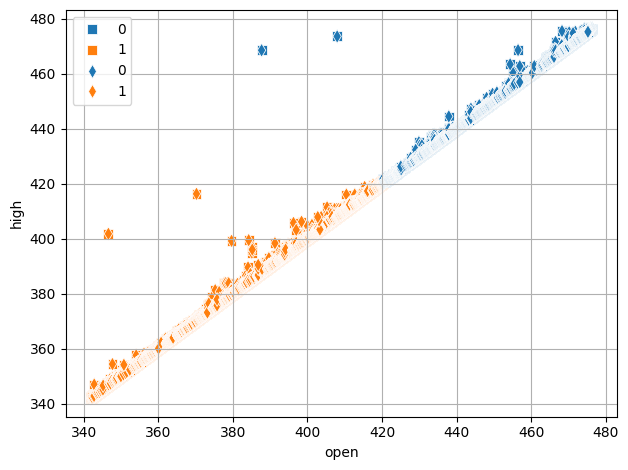

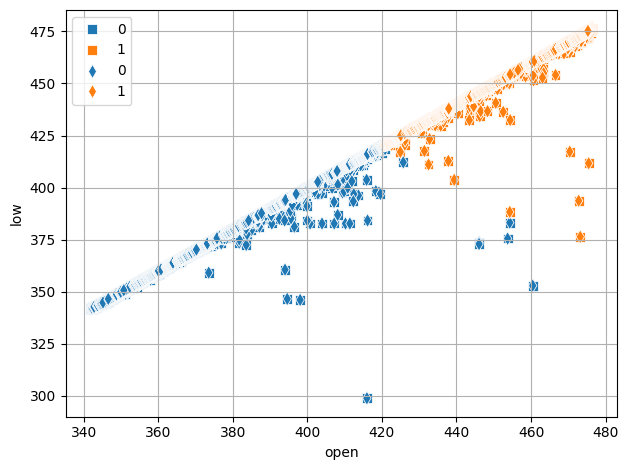

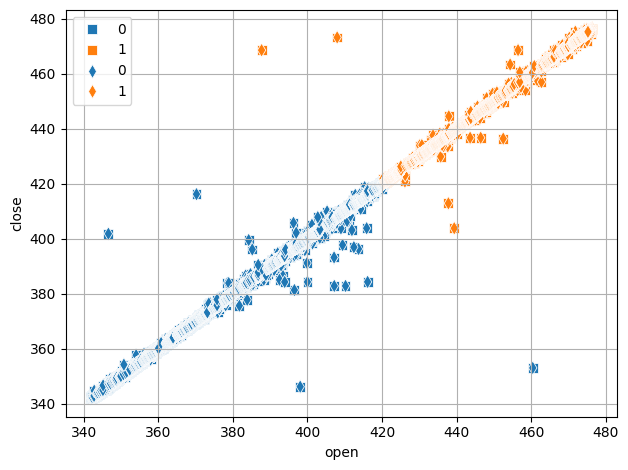

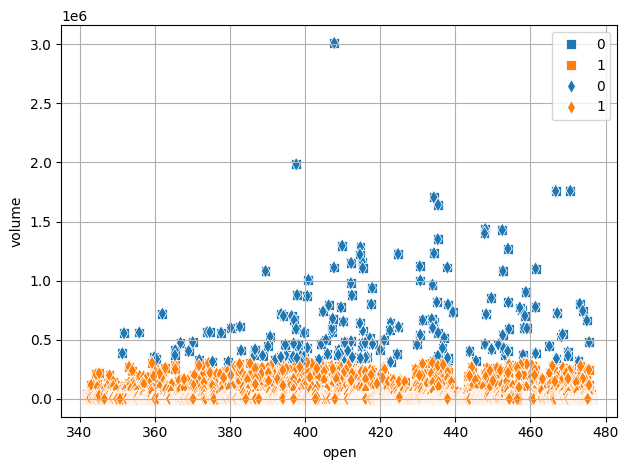

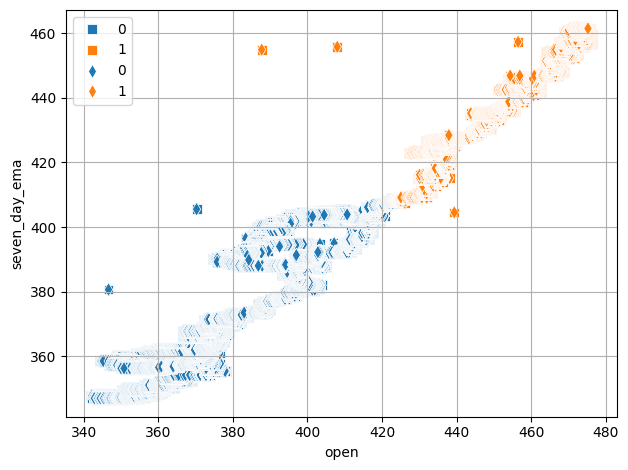

...

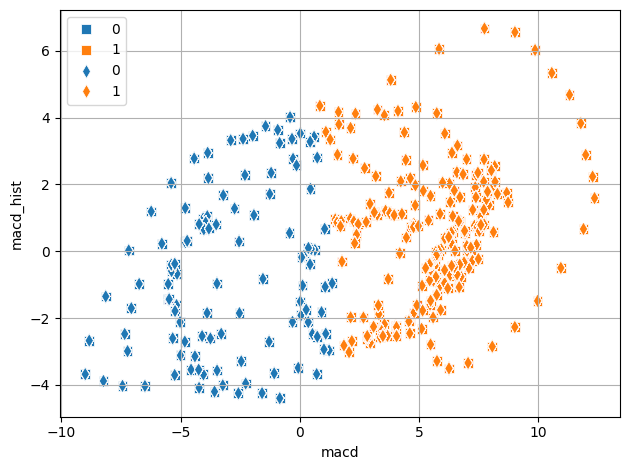

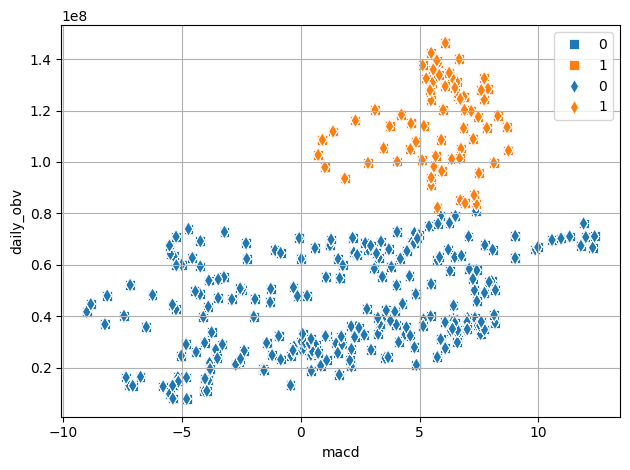

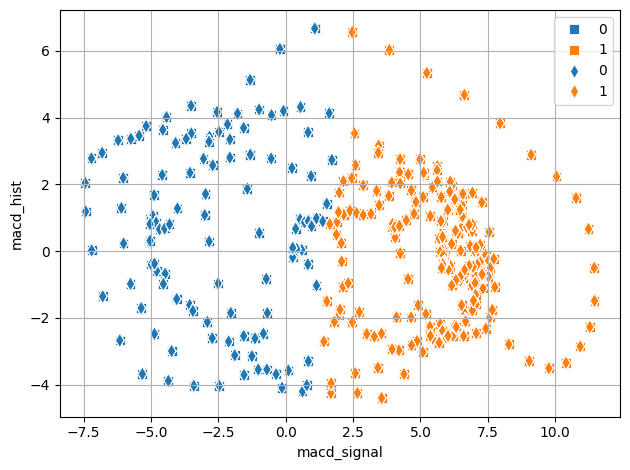

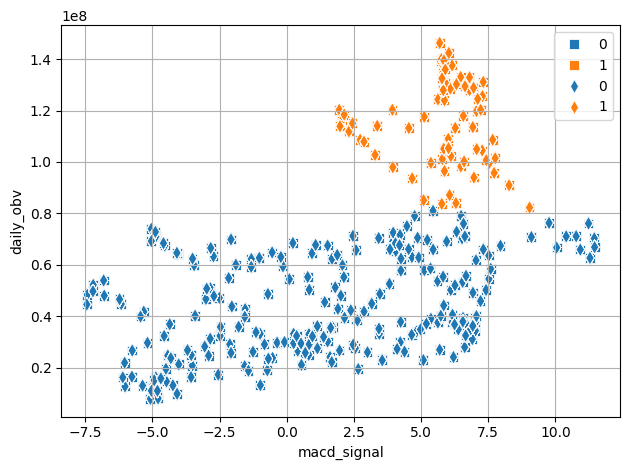

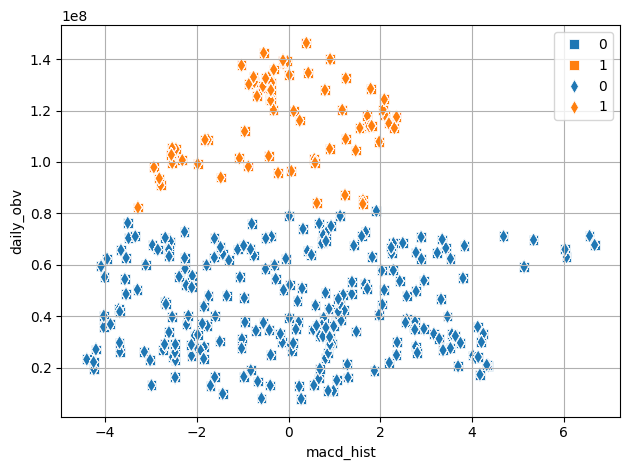

In [10]:
for pair in cluster_pair_combo:
    df_plot_fields = df[[pair[0], pair[1]]]
    print_cluster(kmeans_model, 2, df_plot_fields)

# Writeup
For each model prepare a report showing results obtained and hyperparameter values used, justification for dimensionality reduction (or not) including supporting data, resulting conclusions for each model regarding potential fit. 

Hyper-parameters used: 
* n_clusters=2
* init='random'
* n_init=10
* max_iter=300
* tol=1e-04
* random_state=0

I settled on 2 clusters since I want to visually observe each pairs relationship to understand if there might be any strong relationships between fields. I also want to color it by the target price to see if any 2-pair combination of fields very noticably slices the target field. 
I set the initial cluster locations to random. I have no strong preference on this value and don't expect it to matter given enough iterations. 
n_init set to 10 to increase probability we don't have bad initial start seeds
max_iter to 300. Just a large enough number to again ensure we have good clusters but not so many that there aren't performance improvements relative to the time trade-off of running the algorithm many more times. 
tol=set to default value
random_state set to 0 to ensure reproducability of results. 

I did not use dimensionality reduction since I'm using unsupervised learning in this problem. If you don't know what the target field is there isn't a way to choose the top k best features since by definition of the problem there is no target to take the best feauters of. 



    